In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from collections import deque

# Define the Tic-Tac-Toe board class
class TicTacToe:
    def __init__(self):
        self.board = np.zeros((3, 3), dtype=int)  # 0 for empty, 1 for 'X', -1 for 'O'

    def display_board(self):
        """Display the current board using matplotlib"""
        fig, ax = plt.subplots()
        ax.set_xticks(np.arange(0.5, 3.5, 1))
        ax.set_yticks(np.arange(0.5, 3.5, 1))
        ax.grid(color='black', linestyle='-', linewidth=2)

        # Set grid limits
        ax.set_xlim(0, 3)
        ax.set_ylim(0, 3)

        # Draw Xs and Os
        for i in range(3):
            for j in range(3):
                if self.board[i, j] == 1:
                    ax.text(j + 0.5, 2.5 - i, 'X', fontsize=40, ha='center', va='center', color='blue')
                elif self.board[i, j] == -1:
                    ax.text(j + 0.5, 2.5 - i, 'O', fontsize=40, ha='center', va='center', color='red')

        # Remove tick marks and labels
        ax.set_xticks([])
        ax.set_yticks([])
        plt.show()

    def is_winner(self, player):
        """Check if a player has won"""
        win_states = [
            self.board[0, :], self.board[1, :], self.board[2, :],  # rows
            self.board[:, 0], self.board[:, 1], self.board[:, 2],  # columns
            np.diag(self.board), np.diag(np.fliplr(self.board))    # diagonals
        ]
        return any(np.all(state == player) for state in win_states)

    def is_draw(self):
        """Check if the game is a draw"""
        return np.all(self.board != 0)

    def get_available_moves(self):
        """Get a list of available moves (empty positions)"""
        return [(i, j) for i in range(3) for j in range(3) if self.board[i, j] == 0]

    def make_move(self, i, j, player):
        """Place a move on the board"""
        self.board[i, j] = player
        self.display_board()

    def undo_move(self, i, j):
        """Undo a move"""
        self.board[i, j] = 0

# BFS Algorithm
def bfs_search(game, player):
    """BFS to find a winning move"""
    queue = deque([(game.board.copy(), player)])
    while queue:
        current_state, current_player = queue.popleft()
        game.board = current_state

        if game.is_winner(current_player):
            return True

        if game.is_draw():
            continue

        for move in game.get_available_moves():
            game.make_move(move[0], move[1], current_player)
            queue.append((game.board.copy(), -current_player))
            game.undo_move(move[0], move[1])

    return False

# DFS Algorithm
def dfs_search(game, player):
    """DFS to find a winning move"""
    stack = [(game.board.copy(), player)]
    while stack:
        current_state, current_player = stack.pop()
        game.board = current_state

        if game.is_winner(current_player):
            return True

        if game.is_draw():
            continue

        for move in game.get_available_moves():
            game.make_move(move[0], move[1], current_player)
            stack.append((game.board.copy(), -current_player))
            game.undo_move(move[0], move[1])

    return False

# A* Algorithm
def heuristic(game, player):
    """A simple heuristic function for Tic-Tac-Toe"""
    score = 0
    for row in game.board:
        if np.all(row == player):
            score += 1
    for col in game.board.T:
        if np.all(col == player):
            score += 1
    if np.all(np.diag(game.board) == player):
        score += 1
    if np.all(np.diag(np.fliplr(game.board)) == player):
        score += 1
    return score

def a_star_search(game, player):
    """A* search with a heuristic"""
    queue = deque([(game.board.copy(), player, 0)])  # board, player, heuristic score
    while queue:
        current_state, current_player, h = queue.popleft()
        game.board = current_state

        if game.is_winner(current_player):
            return True

        if game.is_draw():
            continue

        for move in game.get_available_moves():
            game.make_move(move[0], move[1], current_player)
            score = heuristic(game, current_player)
            queue.append((game.board.copy(), -current_player, score))
            queue = deque(sorted(queue, key=lambda x: x[2], reverse=True))  # Sort by heuristic
            game.undo_move(move[0], move[1])

    return False

# Running the game
game = TicTacToe()

# Display the initial empty board
game.display_board()

# Select player X (1) or O (-1)
current_player = 1

# Make moves using BFS, DFS, or A*:
print("Running BFS Search:")
bfs_result = bfs_search(game, current_player)

print("Running DFS Search:")
dfs_result = dfs_search(game, current_player)

print("Running A* Search:")
a_star_result = a_star_search(game, current_player)

# Display results
print(f"BFS result: {bfs_result}")
print(f"DFS result: {dfs_result}")
print(f"A* result: {a_star_result}")

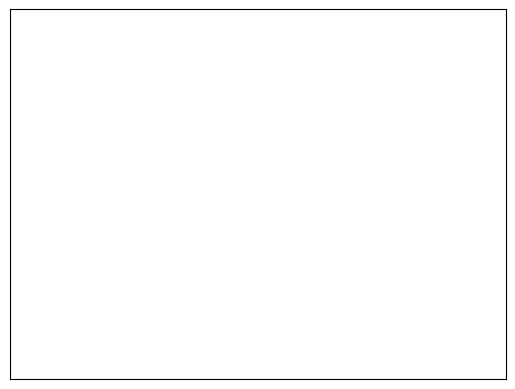

Running BFS Search:


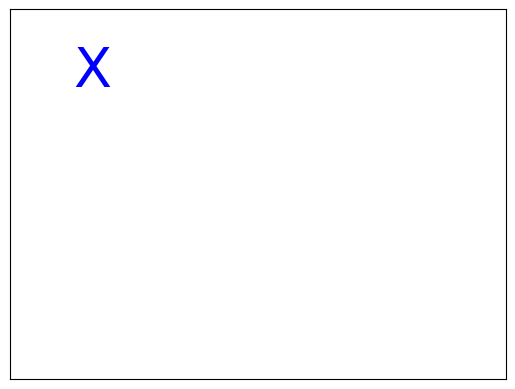

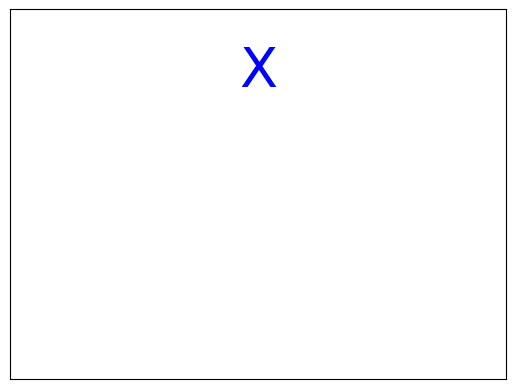

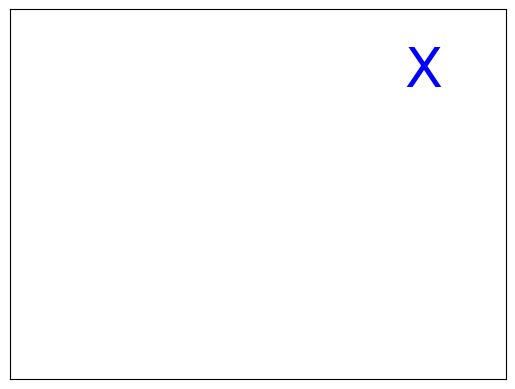

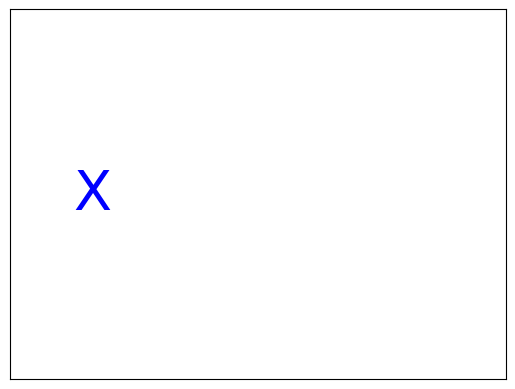

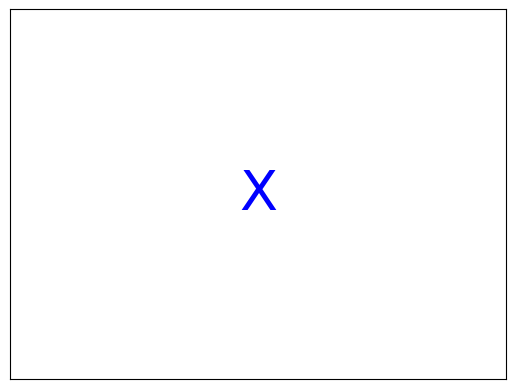

...

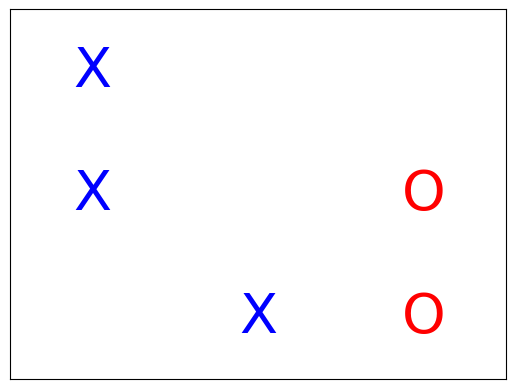

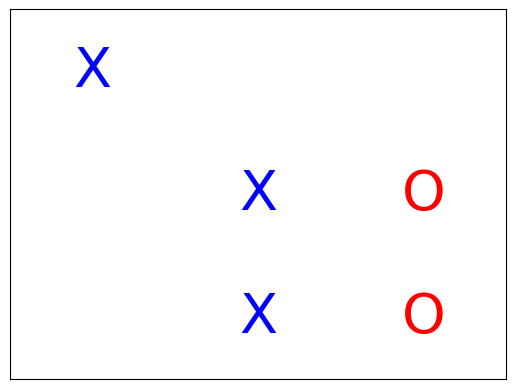

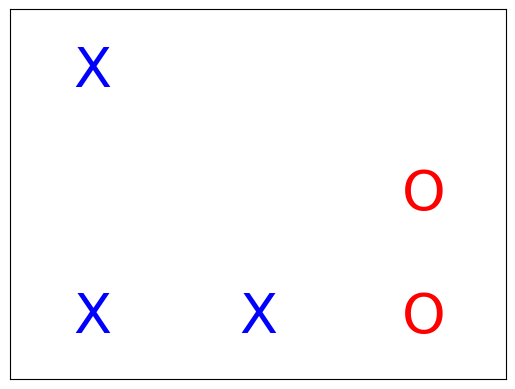

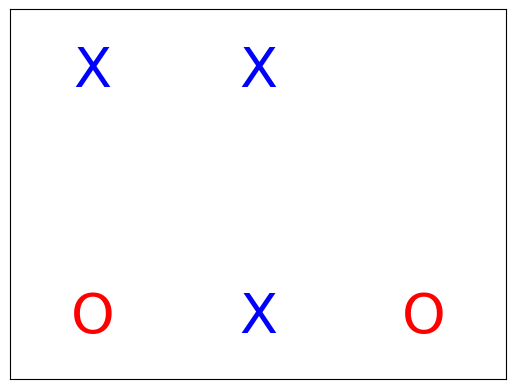

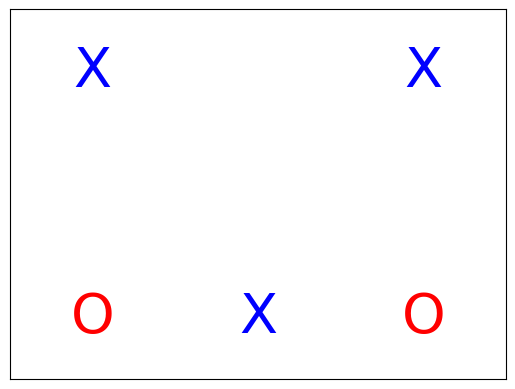

In [ ]:
import numpy as np
import matplotlib.pyplot as plt
from collections import deque

# Define the Tic-Tac-Toe board class
class TicTacToe:
    def __init__(self):
        self.board = np.zeros((3, 3), dtype=int)  # 0 for empty, 1 for 'X', -1 for 'O'

    def display_board(self):
        """Display the current board using matplotlib"""
        fig, ax = plt.subplots()
        ax.set_xticks(np.arange(0.5, 3.5, 1))
        ax.set_yticks(np.arange(0.5, 3.5, 1))
        ax.grid(color='black', linestyle='-', linewidth=2)

        # Set grid limits
        ax.set_xlim(0, 3)
        ax.set_ylim(0, 3)

        # Draw Xs and Os
        for i in range(3):
            for j in range(3):
                if self.board[i, j] == 1:
                    ax.text(j + 0.5, 2.5 - i, 'X', fontsize=40, ha='center', va='center', color='blue')
                elif self.board[i, j] == -1:
                    ax.text(j + 0.5, 2.5 - i, 'O', fontsize=40, ha='center', va='center', color='red')

        # Remove tick marks and labels
        ax.set_xticks([])
        ax.set_yticks([])
        plt.show()

    def is_winner(self, player):
        """Check if a player has won"""
        win_states = [
            self.board[0, :], self.board[1, :], self.board[2, :],  # rows
            self.board[:, 0], self.board[:, 1], self.board[:, 2],  # columns
            np.diag(self.board), np.diag(np.fliplr(self.board))    # diagonals
        ]
        return any(np.all(state == player) for state in win_states)

    def is_draw(self):
        """Check if the game is a draw"""
        return np.all(self.board != 0)

    def get_available_moves(self):
        """Get a list of available moves (empty positions)"""
        return [(i, j) for i in range(3) for j in range(3) if self.board[i, j] == 0]

    def make_move(self, i, j, player):
        """Place a move on the board"""
        self.board[i, j] = player
        self.display_board()

    def undo_move(self, i, j):
        """Undo a move"""
        self.board[i, j] = 0

# BFS Algorithm
def bfs_search(game, player):
    """BFS to find a winning move"""
    queue = deque([(game.board.copy(), player)])
    while queue:
        current_state, current_player = queue.popleft()
        game.board = current_state

        if game.is_winner(current_player):
            return True

        if game.is_draw():
            continue

        for move in game.get_available_moves():
            game.make_move(move[0], move[1], current_player)
            queue.append((game.board.copy(), -current_player))
            game.undo_move(move[0], move[1])

    return False

# DFS Algorithm
def dfs_search(game, player):
    """DFS to find a winning move"""
    stack = [(game.board.copy(), player)]
    while stack:
        current_state, current_player = stack.pop()
        game.board = current_state

        if game.is_winner(current_player):
            return True

        if game.is_draw():
            continue

        for move in game.get_available_moves():
            game.make_move(move[0], move[1], current_player)
            stack.append((game.board.copy(), -current_player))
            game.undo_move(move[0], move[1])

    return False

# A* Algorithm
def heuristic(game, player):
    """A simple heuristic function for Tic-Tac-Toe"""
    score = 0
    for row in game.board:
        if np.all(row == player):
            score += 1
    for col in game.board.T:
        if np.all(col == player):
            score += 1
    if np.all(np.diag(game.board) == player):
        score += 1
    if np.all(np.diag(np.fliplr(game.board)) == player):
        score += 1
    return score

def a_star_search(game, player):
    """A* search with a heuristic"""
    queue = deque([(game.board.copy(), player, 0)])  # board, player, heuristic score
    while queue:
        current_state, current_player, h = queue.popleft()
        game.board = current_state

        if game.is_winner(current_player):
            return True

        if game.is_draw():
            continue

        for move in game.get_available_moves():
            game.make_move(move[0], move[1], current_player)
            score = heuristic(game, current_player)
            queue.append((game.board.copy(), -current_player, score))
            queue = deque(sorted(queue, key=lambda x: x[2], reverse=True))  # Sort by heuristic
            game.undo_move(move[0], move[1])

    return False

# Running the game
game = TicTacToe()

# Display the initial empty board
game.display_board()

# Select player X (1) or O (-1)
current_player = 1

# Make moves using BFS, DFS, or A*:
print("Running BFS Search:")
bfs_result = bfs_search(game, current_player)

print("Running DFS Search:")
dfs_result = dfs_search(game, current_player)

print("Running A* Search:")
a_star_result = a_star_search(game, current_player)

# Display results
print(f"BFS result: {bfs_result}")
print(f"DFS result: {dfs_result}")
print(f"A* result: {a_star_result}")